In [296]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import linear_model
from sklearn.metrics import r2_score
from pandas.plotting import scatter_matrix


In [297]:
data = pd.read_csv(
    "melb_data.csv"
)

In [298]:
data.head(n = 5)

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


In [299]:
data.describe(include="all")

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
count,13580,13580,13580.000000,13580,1.358000e+04,13580,13580,13580,13580.000000,13580.000000,...,13580.000000,13518.000000,13580.000000,7130.000000,8205.000000,12211,13580.000000,13580.000000,13580,13580.000000
unique,314,13378,NaN,3,NaN,5,268,58,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,33,NaN,NaN,8,NaN
top,Reservoir,14 Arthur St,NaN,h,NaN,S,Nelson,27/05/2017,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Moreland,NaN,NaN,Southern Metropolitan,NaN
freq,359,3,NaN,9449,NaN,9022,1565,473,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1163,NaN,NaN,4695,NaN
mean,NaN,NaN,2.937997,NaN,1.075684e+06,NaN,NaN,NaN,10.137776,3105.301915,...,1.534242,1.610075,558.416127,151.967650,1964.684217,NaN,-37.809203,144.995216,NaN,7454.417378
std,NaN,NaN,0.955748,NaN,6.393107e+05,NaN,NaN,NaN,5.868725,90.676964,...,0.691712,0.962634,3990.669241,541.014538,37.273762,NaN,0.079260,0.103916,NaN,4378.581772
min,NaN,NaN,1.000000,NaN,8.500000e+04,NaN,NaN,NaN,0.000000,3000.000000,...,0.000000,0.000000,0.000000,0.000000,1196.000000,NaN,-38.182550,144.431810,NaN,249.000000
25%,NaN,NaN,2.000000,NaN,6.500000e+05,NaN,NaN,NaN,6.100000,3044.000000,...,1.000000,1.000000,177.000000,93.000000,1940.000000,NaN,-37.856822,144.929600,NaN,4380.000000
50%,NaN,NaN,3.000000,NaN,9.030000e+05,NaN,NaN,NaN,9.200000,3084.000000,...,1.000000,2.000000,440.000000,126.000000,1970.000000,NaN,-37.802355,145.000100,NaN,6555.000000
75%,NaN,NaN,3.000000,NaN,1.330000e+06,NaN,NaN,NaN,13.000000,3148.000000,...,2.000000,2.000000,651.000000,174.000000,1999.000000,NaN,-37.756400,145.058305,NaN,10331.000000


In [300]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13580 entries, 0 to 13579
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         13580 non-null  object 
 1   Address        13580 non-null  object 
 2   Rooms          13580 non-null  int64  
 3   Type           13580 non-null  object 
 4   Price          13580 non-null  float64
 5   Method         13580 non-null  object 
 6   SellerG        13580 non-null  object 
 7   Date           13580 non-null  object 
 8   Distance       13580 non-null  float64
 9   Postcode       13580 non-null  float64
 10  Bedroom2       13580 non-null  float64
 11  Bathroom       13580 non-null  float64
 12  Car            13518 non-null  float64
 13  Landsize       13580 non-null  float64
 14  BuildingArea   7130 non-null   float64
 15  YearBuilt      8205 non-null   float64
 16  CouncilArea    12211 non-null  object 
 17  Lattitude      13580 non-null  float64
 18  Longti

In [301]:
data['Car'].fillna(value=0, inplace= True)

In [302]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13580 entries, 0 to 13579
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         13580 non-null  object 
 1   Address        13580 non-null  object 
 2   Rooms          13580 non-null  int64  
 3   Type           13580 non-null  object 
 4   Price          13580 non-null  float64
 5   Method         13580 non-null  object 
 6   SellerG        13580 non-null  object 
 7   Date           13580 non-null  object 
 8   Distance       13580 non-null  float64
 9   Postcode       13580 non-null  float64
 10  Bedroom2       13580 non-null  float64
 11  Bathroom       13580 non-null  float64
 12  Car            13580 non-null  float64
 13  Landsize       13580 non-null  float64
 14  BuildingArea   7130 non-null   float64
 15  YearBuilt      8205 non-null   float64
 16  CouncilArea    12211 non-null  object 
 17  Lattitude      13580 non-null  float64
 18  Longti

In [303]:
data['Bedroom2'].describe()

count    13580.000000
mean         2.914728
std          0.965921
min          0.000000
25%          2.000000
50%          3.000000
75%          3.000000
max         20.000000
Name: Bedroom2, dtype: float64

In [304]:
data_corr = data.corr()
data_corr['Price'].sort_values(ascending=False)

Price            1.000000
Rooms            0.496634
Bedroom2         0.475951
Bathroom         0.467038
Car              0.234825
Longtitude       0.203656
Postcode         0.107867
BuildingArea     0.090981
Landsize         0.037507
Propertycount   -0.042153
Distance        -0.162522
Lattitude       -0.212934
YearBuilt       -0.323617
Name: Price, dtype: float64

In [305]:
backup_data = data

In [306]:
backup_data.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


In [307]:
data = backup_data

data.describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,13580.000000,1.358000e+04,13580.000000,13580.000000,13580.000000,13580.000000,13580.000000,13580.000000,7130.000000,8205.000000,13580.000000,13580.000000,13580.000000
mean,2.937997,1.075684e+06,10.137776,3105.301915,2.914728,1.534242,1.602725,558.416127,151.967650,1964.684217,-37.809203,144.995216,7454.417378
std,0.955748,6.393107e+05,5.868725,90.676964,0.965921,0.691712,0.966548,3990.669241,541.014538,37.273762,0.079260,0.103916,4378.581772
min,1.000000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1196.000000,-38.182550,144.431810,249.000000
25%,2.000000,6.500000e+05,6.100000,3044.000000,2.000000,1.000000,1.000000,177.000000,93.000000,1940.000000,-37.856822,144.929600,4380.000000
50%,3.000000,9.030000e+05,9.200000,3084.000000,3.000000,1.000000,2.000000,440.000000,126.000000,1970.000000,-37.802355,145.000100,6555.000000
75%,3.000000,1.330000e+06,13.000000,3148.000000,3.000000,2.000000,2.000000,651.000000,174.000000,1999.000000,-37.756400,145.058305,10331.000000
max,10.000000,9.000000e+06,48.100000,3977.000000,20.000000,8.000000,10.000000,433014.000000,44515.000000,2018.000000,-37.408530,145.526350,21650.000000


In [308]:
index_highprice = data[data['Price'] > (500 * 1e4)].index
data.drop(index_highprice, inplace=True)

index_highroom = data[data['Rooms'] > 7].index
data.drop(index_highroom, inplace= True)

index_highbedroom = data[data['Bedroom2'] > 7].index
data.drop(index_highbedroom, inplace = True)

index_highDist = data[data['Distance'] > 35].index
data.drop(index_highDist, inplace = True)

index_uselesspost = data[data['Postcode'] > 3250].index
data.drop(index_uselesspost, inplace = True)


In [309]:
data.describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,13280.00000,1.328000e+04,13280.000000,13280.000000,13280.000000,13280.000000,13280.000000,13280.000000,6952.000000,8016.000000,13280.000000,13280.000000,13280.000000
mean,2.92131,1.077056e+06,9.688072,3096.929970,2.895783,1.524699,1.591416,538.055346,144.770442,1964.348428,-37.808774,144.995308,7432.246461
std,0.94533,6.110923e+05,4.886750,59.663144,0.942098,0.679318,0.959415,3930.342893,129.458588,37.367073,0.072375,0.096982,4362.104773
min,1.00000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1196.000000,-38.114710,144.598640,389.000000
25%,2.00000,6.520000e+05,6.100000,3044.000000,2.000000,1.000000,1.000000,171.750000,92.000000,1940.000000,-37.856200,144.930300,4380.000000
50%,3.00000,9.100000e+05,9.200000,3083.000000,3.000000,1.000000,2.000000,426.000000,125.000000,1970.000000,-37.802400,144.999665,6543.000000
75%,3.00000,1.338500e+06,12.800000,3146.000000,3.000000,2.000000,2.000000,650.000000,172.000000,1999.000000,-37.757715,145.056203,10331.000000
max,7.00000,4.900000e+06,34.900000,3207.000000,7.000000,7.000000,10.000000,433014.000000,6791.000000,2018.000000,-37.568570,145.337380,21650.000000


<AxesSubplot:xlabel='Price', ylabel='Car'>

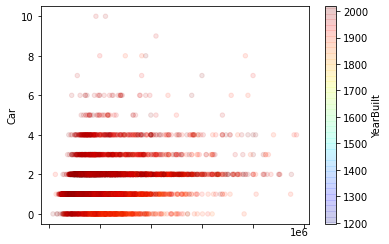

In [310]:
data.plot(
    x = 'Price',
    y = 'Car',
    kind = 'scatter',
    c = 'YearBuilt',
    cmap = plt.get_cmap('jet'),
    colorbar = True,
    alpha = 0.11
)

array([[<AxesSubplot:xlabel='Price', ylabel='Price'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Price'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel='Price'>,
        <AxesSubplot:xlabel='Bathroom', ylabel='Price'>,
        <AxesSubplot:xlabel='Car', ylabel='Price'>],
       [<AxesSubplot:xlabel='Price', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Bathroom', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Car', ylabel='Rooms'>],
       [<AxesSubplot:xlabel='Price', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Bathroom', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Car', ylabel='Bedroom2'>],
       [<AxesSubplot:xlabel='Price', ylabel='Bathroom'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Bathroom'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel

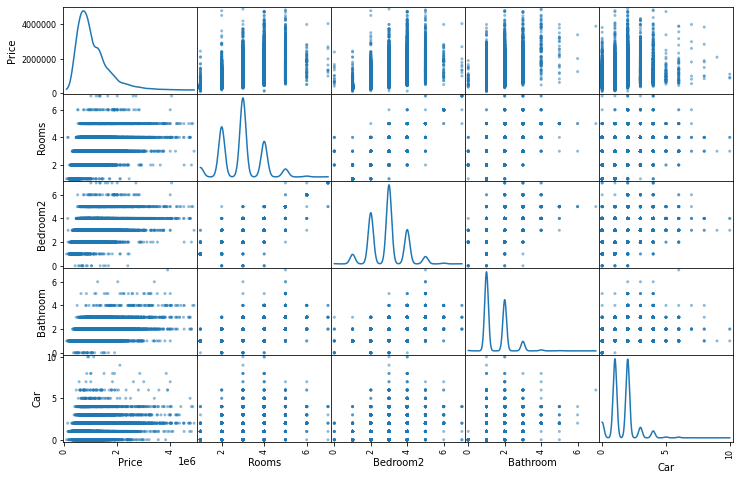

In [311]:
attributes = ['Price', 'Rooms', 'Bedroom2', 'Bathroom', 'Car']
scatter_matrix(data[attributes], figsize = (12, 8), diagonal='kde')

In [312]:
data.describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,13280.00000,1.328000e+04,13280.000000,13280.000000,13280.000000,13280.000000,13280.000000,13280.000000,6952.000000,8016.000000,13280.000000,13280.000000,13280.000000
mean,2.92131,1.077056e+06,9.688072,3096.929970,2.895783,1.524699,1.591416,538.055346,144.770442,1964.348428,-37.808774,144.995308,7432.246461
std,0.94533,6.110923e+05,4.886750,59.663144,0.942098,0.679318,0.959415,3930.342893,129.458588,37.367073,0.072375,0.096982,4362.104773
min,1.00000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1196.000000,-38.114710,144.598640,389.000000
25%,2.00000,6.520000e+05,6.100000,3044.000000,2.000000,1.000000,1.000000,171.750000,92.000000,1940.000000,-37.856200,144.930300,4380.000000
50%,3.00000,9.100000e+05,9.200000,3083.000000,3.000000,1.000000,2.000000,426.000000,125.000000,1970.000000,-37.802400,144.999665,6543.000000
75%,3.00000,1.338500e+06,12.800000,3146.000000,3.000000,2.000000,2.000000,650.000000,172.000000,1999.000000,-37.757715,145.056203,10331.000000
max,7.00000,4.900000e+06,34.900000,3207.000000,7.000000,7.000000,10.000000,433014.000000,6791.000000,2018.000000,-37.568570,145.337380,21650.000000
